In [1]:
#from google.colab import drive
#drive.mount('/content/drive')

<h2>Let's Take a look at the dataframe: </h2>
<p>Let's take a look at each of the column of the dataframe and decide which of the columns we don't require for the analysis. </p>
<div> </div>
<p> From the dataframe let's take into notice, the references by the columns. <p>
<table> 
  <th>Serial Number: </th>
  <th>Column Header: </th>
  <th> Refernce by the column </th>
  <tr> 
    <td>01.</td>
    <td> time</td>
    <td> Time of the earthquake event </td>
  </tr>
  <tr>
    <td>02.</td>
    <td>latitude</td>
    <td>Latitude of the recorded event</td>
  </tr>
  <tr>
    <td>03.</td>
    <td>longitude</td>
    <td>Longitude of the recorde event</td>
  </tr>
  <tr>
    <td>04.</td>
    <td>depth</td>
    <td>The depth where the earthquake begins to rupture</td>
  </tr>
  <tr>
    <td>05.</td>
    <td>mag</td>
    <td>Magnitude of the event recorded. </td>
  </tr>
  <tr>
    <td>06.</td>
    <td>magType</td>
    <td>The method or algorithm used to calculate the preferred magnitude for the event</td>
  </tr>
  <tr>
    <td>07.</td>
    <td>nst</td>
    <td>The total number of seismic stations used to determine earthquake location</td>
  </tr>
  <tr>
    <td>08.</td>
    <td>gap</td>
    <td>The largest azimuthal gap between azimuthally adjacent stations (in degrees)</td>
  </tr>
  <tr>
    <td>09.</td>
    <td>rms</td>
    <td>The root-mean-square (RMS) travel time residual, in sec, using all weights</td>
  </tr>
  <tr>
    <td>10.</td>
    <td>id</td>
    <td>A unique identifier for the event.</td>
  </tr>
  <tr>
    <td>11.</td>
    <td>updated</td>
    <td>Time when the event was most recently updated.</td>
  </tr>
  <tr>
    <td>12.</td>
    <td>place</td>
    <td>Textual description of named geographic region near to the event.</td>
  </tr>
  <tr>
    <td>13.</td>
    <td>type</td>
    <td>Type of the incident recorded.</td>
  </tr>
  <tr>
    <td>14.</td>
    <td>horizontalError</td>
    <td>Uncertainty of reported location of the event in kilometers</td>
  </tr>
  <tr>
    <td>15.</td>
    <td>depthError</td>
    <td>Uncertainty of reported depth of the event in kilometers</td>
  </tr>
  <tr>
    <td>16.</td>
    <td>magError</td>
    <td>Uncertainty of reported magnitude of the event</td>
  </tr>
  <tr>
    <td>17.</td>
    <td>magNst</td>
    <td>The total number of seismic stations used to calculate the magnitude for this earthquake</td>
  </tr>
  <tr>
    <td>18.</td>
    <td>status</td>
    <td>Status of the recorded event.</td>
  </tr>
  <tr>
    <td>19.</td>
    <td>dmin</td>
    <td>Horizontal distance from the epicenter to the nearest station (in degrees)</td>
  </tr>
  <tr>
    <td>20.</td>
    <td>locationSource</td>
    <td>The network that originally authored the reported location of this event</td>
  </tr>
  <tr>
    <td>21.</td>
    <td>magSource</td>
    <td>The network that originally authored the reported magnitude of the event.</td>
  </tr>

In [2]:
import folium
import pandas as pd

# this feed tracks every earthquake of magnitude 2.5 or greater over the last month
df = pd.read_csv('earthquake.csv')

df.info() # let's take a look at our available columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11363 entries, 0 to 11362
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   time             11363 non-null  object 
 1   latitude         11363 non-null  float64
 2   longitude        11363 non-null  float64
 3   depth            11363 non-null  float64
 4   mag              11362 non-null  float64
 5   magType          11362 non-null  object 
 6   nst              8256 non-null   float64
 7   gap              9290 non-null   float64
 8   dmin             7825 non-null   float64
 9   rms              11360 non-null  float64
 10  net              11363 non-null  object 
 11  id               11363 non-null  object 
 12  updated          11363 non-null  object 
 13  place            11363 non-null  object 
 14  type             11363 non-null  object 
 15  horizontalError  8090 non-null   float64
 16  depthError       11363 non-null  float64
 17  magError    

In [3]:
!pip install folium
#!pip install progressbar

In [4]:
df['time'] = pd.to_datetime(df['time'])
df['updated'] = pd.to_datetime(df['updated'])

#change the Time and updated time varibale data types from object to datetime format 

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11363 entries, 0 to 11362
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype              
---  ------           --------------  -----              
 0   time             11363 non-null  datetime64[ns, UTC]
 1   latitude         11363 non-null  float64            
 2   longitude        11363 non-null  float64            
 3   depth            11363 non-null  float64            
 4   mag              11362 non-null  float64            
 5   magType          11362 non-null  object             
 6   nst              8256 non-null   float64            
 7   gap              9290 non-null   float64            
 8   dmin             7825 non-null   float64            
 9   rms              11360 non-null  float64            
 10  net              11363 non-null  object             
 11  id               11363 non-null  object             
 12  updated          11363 non-null  datetime64[ns, UTC]
 13  place           

In [6]:
df.drop(['magType', 'id', 'magSource', 'locationSource', 'net'], axis = 1, inplace = True)
df.head()

#Removing the unwated variables from dataset to improve the performance and reduce the size.

,time,latitude,longitude,depth,mag,nst,gap,dmin,rms,updated,place,type,horizontalError,depthError,magError,magNst,status
0,2021-10-06 15:28:22.575000+00:00,60.122200,-152.392400,98.100000,1.00,NaN,NaN,NaN,0.67,2021-10-06 15:35:08.762000+00:00,"41 km W of Ninilchik, Alaska",earthquake,NaN,1.60,NaN,NaN,automatic
1,2021-10-06 15:19:09.260000+00:00,19.174000,-155.469330,34.639999,2.49,46.0,90.0,NaN,0.13,2021-10-06 15:24:40.750000+00:00,"3 km SSE of Pāhala, Hawaii",earthquake,0.60,0.89,1.26,24.0,automatic
2,2021-10-06 15:14:44.110000+00:00,19.219166,-155.414337,32.540001,2.21,44.0,149.0,NaN,0.33,2021-10-06 15:20:15.260000+00:00,"6 km ENE of Pāhala, Hawaii",earthquake,0.71,1.07,0.56,4.0,automatic
3,2021-10-06 15:03:39.300000+00:00,38.820000,-122.778831,1.830000,0.45,7.0,109.0,0.006885,0.01,2021-10-06 15:18:11.050000+00:00,"5km W of Cobb, CA",earthquake,0.47,0.92,0.39,2.0,automatic
4,2021-10-06 14:59:15.430000+00:00,38.808334,-122.815331,3.540000,0.63,13.0,58.0,0.010830,0.02,2021-10-06 15:12:11.010000+00:00,"6km NW of The Geysers, CA",earthquake,0.37,0.76,0.06,3.0,automatic


Filling the Nan values of variables with mean values. since we are not going to use any machine learning algorithms so choose this baic method.

In [7]:
df.fillna(df.mean(), inplace = True)
#df.head()

<ipython-input-7-81cbea56c338>:1: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  df.fillna(df.mean(), inplace = True)


Finally lets handle the categorical data, we use Label encoding for status variable and onehot encoding for type variable since its contains nominal data

In [8]:
print(df['type'].value_counts())
print(df['status'].value_counts())

earthquake            11088
quarry blast            161
explosion                56
ice quake                52
chemical explosion        3
other event               2
sonic boom                1
Name: type, dtype: int64
reviewed     8259
automatic    3104
Name: status, dtype: int64


label encoding the status variable

In [9]:
df['status'] = df['status'].apply(lambda x:1 if (x =='reviewed') else 0)
# earth_quake_dataframe['type'] = earth_quake_dataframe['type'].apply(lambda x:1 if (x=='earthquake') else 0)
#df.head(2)

one hot encode the type variable

In [10]:
encoded_df = pd.get_dummies(df[['type']], prefix = "", prefix_sep = "")
earth_quake_encoded = df.join(encoded_df)
earth_quake_encoded.drop(['type'], axis = 1, inplace = True)
print(earth_quake_encoded.head(2))
print(earth_quake_encoded.columns)

                              time  latitude  longitude      depth   mag  \
0 2021-10-06 15:28:22.575000+00:00   60.1222 -152.39240  98.100000  1.00   
1 2021-10-06 15:19:09.260000+00:00   19.1740 -155.46933  34.639999  2.49   

         nst         gap      dmin   rms                          updated  \
0  20.547723  114.766548  0.592173  0.67 2021-10-06 15:35:08.762000+00:00   
1  46.000000   90.000000  0.592173  0.13 2021-10-06 15:24:40.750000+00:00   

   ...  magError     magNst  status  chemical explosion  earthquake  \
0  ...  0.303293  14.299117       0                   0           1   
1  ...  1.260000  24.000000       0                   0           1   

   explosion  ice quake  other event  quarry blast  sonic boom  
0          0          0            0             0           0  
1          0          0            0             0           0  

[2 rows x 23 columns]
Index(['time', 'latitude', 'longitude', 'depth', 'mag', 'nst', 'gap', 'dmin',
       'rms', 'updated', 'pla

Making a Base Map in Folium We will start by making a simple map in Folium using the code below. We chose a lat/long of (0, 0) since we are plotting the whole world.

In [11]:
import folium

# create a new map object
m = folium.Map(location=(0, 0), zoom_start=2)

# save our map to an interactive html file
#m.save('world_map.html')
m

Adding Earthquake Data using Folium Circles Now that we have a working base map, let’s plot our earthquakes

In [12]:
m = folium.Map(location=(0, 0), zoom_start=2)

# go through each quake in set, make circle, and add to map.
for i in range(len(df)):
    folium.Circle(
        location=[df.iloc[i]['latitude'], df.iloc[i]['longitude']],
        radius=10,
    ).add_to(m)

# Same as before, we save it to file
#m.save('earthquakes.html')
m


Visualizing Earthquake Magnitudes To give us a quick visual representation of the magnitudes, to alter the size of each circle based on the size of the quake.

radius equal to 50,000 times the magnitude. A 4.0 earthquake would show on my map as having a radius of 200,000m or 200km.

In [13]:
m = folium.Map(location=(0, 0), zoom_start=2)

# go through each home in set, make circle, and add to map.
for i in range(len(df)):
    folium.Circle(
        location=[df.iloc[i]['latitude'], df.iloc[i]['longitude']],
        radius=df.iloc[i]['mag'] * 50000,
        fill_opacity=0.1,
        
    ).add_to(m)

# Same as before, we save it to file
#m.save('earthquakes_based_mag.html')
m

We now see multiple earthquakes on top of each other. In addition to the relative sizes to represent magnitude, the darker red now represents hot spots (multiple quakes), and gives it a heatmap effect.



In [14]:
# Same as before, we get the center and make the map object
m = folium.Map(location=(0, 0), zoom_start=2)

# go through each quake in set, make circle, and add to map.
for i in range(len(df)):
    if df.iloc[i]['mag'] > 3:
        folium.Circle(
            location=[df.iloc[i]['latitude'], df.iloc[i]['longitude']],
            radius=df.iloc[i]['mag'] * 70000,
            weight=1,  # thickness of the border
            color='red',  # this is the color of the border
            opacity=0.3,  # this is the alpha for the border
            fill_color='red',  # fill is inside the circle
            fill_opacity=0.1,  # we will make that less opaque so we can see layers

        ).add_to(m)

# Same as before, we save it to file
#m.save('earthquakes_more_impact.html')
m

Adding Tectonic Plates Using GeoJSON

In [15]:
url = 'https://raw.githubusercontent.com/fraxen/tectonicplates/master/GeoJSON/PB2002_boundaries.json'

folium.GeoJson(
    url,
    name='geojson'
).add_to(m)


folium.LayerControl().add_to(m)


# Same as before, we save it to file
#m.save('earthquakes_vs_tectonic.html')
m

<AxesSubplot:xlabel='rms', ylabel='mag'>

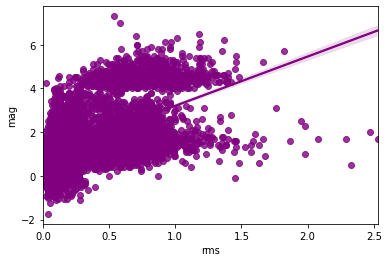

In [16]:
import seaborn as sns
sns.regplot(x= df['rms'], y= df['mag'], data = df, color = 'purple')

Regression plot between Depth and Magnitude: The regression plot between the depth and the magnitude values shows a linear relationship between the two, instead of showing deviations on the both sides.

<AxesSubplot:xlabel='Depth', ylabel='Magnitude'>

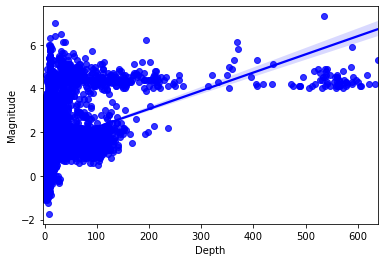

In [17]:
import seaborn as sns
reg_plot_depth_mag = pd.DataFrame(columns =['Depth', 'Magnitude'])
reg_plot_depth_mag['Depth'] = df['depth'].values
reg_plot_depth_mag['Magnitude'] = df['mag'].values
sns.regplot(x=reg_plot_depth_mag['Depth'], y = reg_plot_depth_mag['Magnitude'], data = reg_plot_depth_mag, color = 'blue')

Regression plot between the Root Mean square speed of the waves and the magnitude. The plot shows a linear regression among the two with certain deviations. But we can still ignore the irregularities due to the nature. Due to the not so significant amount of deviation along the regression line proves the linearity of the relationship

Regression plot between the horizontal distance of the recorded place with the depth of the rupture of the waves. The regression plot shows a large amount of deviation meaning that the relationship among the two is not linear

<AxesSubplot:xlabel='dmin', ylabel='mag'>

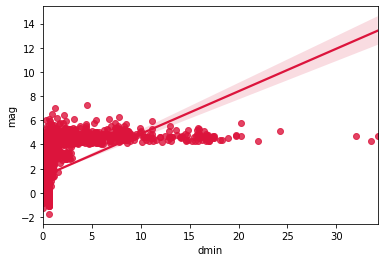

In [18]:
sns.regplot(x= df['dmin'], y = df['mag'], data = df, color = 'crimson')

Get the places with highest earthquakes count for the period of 2010-2019 in USA

In [19]:
count = df['place'].value_counts()

usa_top_earthquakes_df = count.rename_axis('place').reset_index(name='counts')
usa_top_earthquakes_df

#Let's Select top places with atleast 2 earthquake occurance:
usa_top = usa_top_earthquakes_df[0:18]
print(usa_top)
print(usa_top_earthquakes_df.shape)
fetcher = df.set_index('place')
fetched = fetcher.loc[usa_top['place'], ['latitude', 'longitude']]
latitude_to_search = fetched['latitude']
longitude_to_search = fetched['longitude']


                                   place  counts
0              7km NW of The Geysers, CA     159
1           15 km SSE of Sunnyside, Utah     128
2   29 km E of West Yellowstone, Montana     127
3                   10km NNW of Anza, CA     126
4          South Sandwich Islands region      79
5              8km NW of The Geysers, CA      75
6              6km NW of The Geysers, CA      61
7           30km SSW of Smith Valley, NV      52
8             10km NW of The Geysers, CA      45
9            10km WNW of The Geysers, CA      44
10     20 km WSW of Dutch Harbor, Alaska      44
11              31 km SE of Mina, Nevada      43
12                  13km WNW of Anza, CA      42
13     21 km WSW of Dutch Harbor, Alaska      40
14                       West Chile Rise      39
15                     8km W of Cobb, CA      38
16          14 km SSE of Sunnyside, Utah      34
17            6 km ENE of Pāhala, Hawaii      33
(5421, 2)


Let's Plot the vulnerable to earthquakes places to their respective earthquake counts.

<Figure size 1440x720 with 0 Axes>

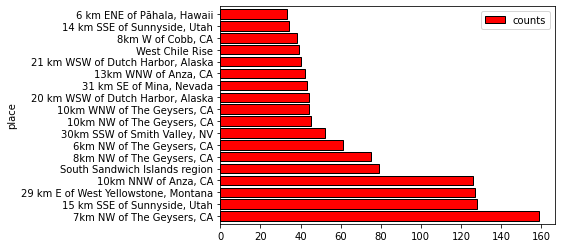

In [20]:
import matplotlib.pyplot as plt
plotter = usa_top.set_index('place')
plt.figure(figsize = (20,10))
plotter.plot(kind = 'barh', width = 0.8, color = 'red', edgecolor = 'black')
plt.show()

Take a printout of the vulnerable cities common names:

In [21]:
place_list = usa_top['place'].unique()
import re
name_list = []
for vals in place_list:
  fg = re.sub('^\d+..\s\w+\s+of','', vals)  #the first parameter is a regex pattern.
  name_list.append(fg)
city_names = pd.DataFrame(columns = ['place'])
city_names['place'] = name_list
unique_cities = city_names['place'].unique()
top_common_places = pd.DataFrame(columns = ['Vulnerable Places'])
top_common_places['Vulnerable Places'] = unique_cities
top_common_places

,Vulnerable Places
0,"The Geysers, CA"
1,"15 km SSE of Sunnyside, Utah"
2,"29 km E of West Yellowstone, Montana"
3,"Anza, CA"
4,South Sandwich Islands region
5,"Smith Valley, NV"
6,"20 km WSW of Dutch Harbor, Alaska"
7,"31 km SE of Mina, Nevada"
8,"21 km WSW of Dutch Harbor, Alaska"
9,West Chile Rise
